# Objective:

Predict which products are likely to go out of stock, understand customer preferences and product popularity, and analyze the impact of pricing strategies on customer satisfaction and sales.


## Key questions:

**Stock Prediction:**

1. Which products are most likely to go out of stock?
   
2. What factors (price, customer reviews, popularity) influence stock availability?
-  how price and other factors impact stock availability
  
3. How does discounts impact product performance in terms of stock, customer reviews, and ratings?

4. How does sales affect product availability (stockout rates)?

5. What is  the impact of pricing strategies (such as discounts and limited edition offerings) on customer satisfaction and sales?

Hypothesis:

Products with higher loves_count, better ratings, and more reviews are more likely to remain in stock.



# Data Ingestion
## Importing libraries to notebook

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
from ydata_profiling import ProfileReport 
import sweetviz as sv
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler, LabelEncoder
%matplotlib inline

pd.set_option('display.max_rows', None) 
pd.set_option('display.max_columns', None)

In [2]:
# read csv file and converting it into a dataframe 
sephora_df = pd.read_csv('product_info.csv')

In [3]:
product_profile = ProfileReport(sephora_df, title="Sephora Profiling Report", explorative=True)
product_profile.to_notebook_iframe()
product_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Data Cleaning and Pre-processing

In [4]:
sephora_df.shape

(8494, 27)

In [5]:
sephora_df.dtypes

product_id             object
product_name           object
brand_id                int64
brand_name             object
loves_count             int64
rating                float64
reviews               float64
size                   object
variation_type         object
variation_value        object
variation_desc         object
ingredients            object
price_usd             float64
value_price_usd       float64
sale_price_usd        float64
limited_edition         int64
new                     int64
online_only             int64
out_of_stock            int64
sephora_exclusive       int64
highlights             object
primary_category       object
secondary_category     object
tertiary_category      object
child_count             int64
child_max_price       float64
child_min_price       float64
dtype: object

In [6]:
sephora_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8494 entries, 0 to 8493
Data columns (total 27 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   product_id          8494 non-null   object 
 1   product_name        8494 non-null   object 
 2   brand_id            8494 non-null   int64  
 3   brand_name          8494 non-null   object 
 4   loves_count         8494 non-null   int64  
 5   rating              8216 non-null   float64
 6   reviews             8216 non-null   float64
 7   size                6863 non-null   object 
 8   variation_type      7050 non-null   object 
 9   variation_value     6896 non-null   object 
 10  variation_desc      1250 non-null   object 
 11  ingredients         7549 non-null   object 
 12  price_usd           8494 non-null   float64
 13  value_price_usd     451 non-null    float64
 14  sale_price_usd      270 non-null    float64
 15  limited_edition     8494 non-null   int64  
 16  new   

We can see from the output above that there are columns that have null values such as the rating, reviews, size, variation_type, variation_value, variation_desc, ingredients, price_usd, sale_price_usd, highlights, secondary category, child_max_price, and child_min_price columns.
The next steps is to handle the missing values for each column.

In [7]:
sephora_df.columns

Index(['product_id', 'product_name', 'brand_id', 'brand_name', 'loves_count',
       'rating', 'reviews', 'size', 'variation_type', 'variation_value',
       'variation_desc', 'ingredients', 'price_usd', 'value_price_usd',
       'sale_price_usd', 'limited_edition', 'new', 'online_only',
       'out_of_stock', 'sephora_exclusive', 'highlights', 'primary_category',
       'secondary_category', 'tertiary_category', 'child_count',
       'child_max_price', 'child_min_price'],
      dtype='object')

In [8]:
# check descriptive statistics of our data
sephora_df.describe()

,brand_id,loves_count,rating,reviews,price_usd,value_price_usd,sale_price_usd,limited_edition,new,online_only,out_of_stock,sephora_exclusive,child_count,child_max_price,child_min_price
count,8494.000000,8.494000e+03,8216.000000,8216.000000,8494.000000,451.000000,270.000000,8494.000000,8494.000000,8494.000000,8494.000000,8494.000000,8494.000000,2754.000000,2754.000000
mean,5422.440546,2.917957e+04,4.194513,448.545521,51.655595,91.168537,20.207889,0.070285,0.071698,0.219096,0.073699,0.279374,1.631622,53.792023,39.665802
std,1709.595957,6.609212e+04,0.516694,1101.982529,53.669234,79.195631,24.327352,0.255642,0.258002,0.413658,0.261296,0.448718,5.379470,58.765894,38.685720
min,1063.000000,0.000000e+00,1.000000,1.000000,3.000000,0.000000,1.750000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,3.000000
25%,5333.000000,3.758000e+03,3.981725,26.000000,25.000000,45.000000,8.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,22.000000,19.000000
50%,6157.500000,9.880000e+03,4.289350,122.000000,35.000000,67.000000,14.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,32.000000,28.000000
75%,6328.000000,2.684125e+04,4.530525,418.000000,58.000000,108.500000,25.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,59.000000,42.000000
max,8020.000000,1.401068e+06,5.000000,21281.000000,1900.000000,617.000000,320.000000,1.000000,1.000000,1.000000,1.000000,1.000000,105.000000,570.000000,400.000000


## Checking and handling missing data

In [9]:
#checking for missing data
#summary of the missing values in descending order
sephora_df.isnull().sum().sort_values(ascending = False)


sale_price_usd        8224
value_price_usd       8043
variation_desc        7244
child_max_price       5740
child_min_price       5740
highlights            2207
size                  1631
variation_value       1598
variation_type        1444
tertiary_category      990
ingredients            945
rating                 278
reviews                278
secondary_category       8
loves_count              0
product_id               0
brand_name               0
product_name             0
brand_id                 0
out_of_stock             0
online_only              0
new                      0
limited_edition          0
price_usd                0
sephora_exclusive        0
primary_category         0
child_count              0
dtype: int64

In [10]:
# Calculate null values in our dataframe
missing_values_counts = sephora_df.isnull().sum()

# Calculate percentage of null values
missing_values_percentage = (missing_values_counts / len(sephora_df)) * 100

# Create a new DataFrame to hold the results
null_summary = pd.DataFrame({'missing values counts': missing_values_counts, 'missing values percentage': missing_values_percentage})
null_summary

,missing values counts,missing values percentage
product_id,0,0.000000
product_name,0,0.000000
brand_id,0,0.000000
brand_name,0,0.000000
loves_count,0,0.000000
rating,278,3.272899
reviews,278,3.272899
size,1631,19.201789
variation_type,1444,17.000235
variation_value,1598,18.813280


In [11]:
# Create a copy
df = sephora_df.copy()
df.shape

(8494, 27)

## Step 1: Handle missing data in reviews

In [12]:
# Ensure all missing values are represented by NaN
df.replace(['', ' ', None], np.nan, inplace=True)

In [13]:
# check the rows with the missing values
missing_reviews = df[df['reviews'].isna()]


In [14]:
# Going to group the products by brand and then find the median of the reviews and fill the missing values with it 
# Group by 'brand_id' or 'brand_name' and calculate median reviews for each brand
brand_median = df.groupby('brand_id')['reviews'].transform('median')

In [15]:
#Replacing the missing values in the reviews column with the brand median
df['reviews'] = df['reviews'].fillna(brand_median)

In [16]:
df.reviews.isnull().sum()

np.int64(11)

In [17]:
remaining_missing_values = df[df['reviews'].isnull()]
remaining_missing_values

,product_id,product_name,brand_id,brand_name,loves_count,rating,reviews,size,variation_type,variation_value,variation_desc,ingredients,price_usd,value_price_usd,sale_price_usd,limited_edition,new,online_only,out_of_stock,sephora_exclusive,highlights,primary_category,secondary_category,tertiary_category,child_count,child_max_price,child_min_price
6118,P502690,"Snow Angel Shampoo, Shower Gel & Bubble Bath",3866,philosophy,1266,NaN,NaN,16 oz / 480 mL,Size,16 oz / 480 mL,NaN,"['Water⁄Aqua⁄Eau, Sodium Laureth Sulfate, Ppg-...",24.0,NaN,NaN,0,0,0,1,0,NaN,Bath & Body,Value & Gift Sets,NaN,0,NaN,NaN
7626,P505471,Maker Perfume Discovery Kit,6380,The Maker,113,NaN,NaN,NaN,NaN,NaN,NaN,"['Fire Eau De Parfum:', 'Alcohol Denat., Fragr...",35.0,NaN,NaN,0,1,1,1,0,"['Vegan', 'Unisex/ Genderless Scent', 'Clean +...",Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN
7627,P505453,Naked Eau de Parfum,6380,The Maker,44,NaN,NaN,1.7 oz / 50 mL,Size + Concentration + Formulation,1.7 oz / 50 mL eau de parfum spray,NaN,"['Alcohol denat., Fragrance (parfum), Water (e...",175.0,NaN,NaN,0,1,1,1,0,"['Vegan', 'Unisex/ Genderless Scent', 'Clean +...",Fragrance,Women,Perfume,1,42.0,42.0
7628,P505459,Fire Eau de Parfum,6380,The Maker,37,NaN,NaN,1.7 oz / 50 mL,Size + Concentration + Formulation,1.7 oz / 50 mL eau de parfum spray,NaN,"['Alcohol Denat., Fragrance (parfum), Water (e...",175.0,NaN,NaN,0,1,1,1,0,"['Vegan', 'Unisex/ Genderless Scent', 'Clean +...",Fragrance,Women,Perfume,0,NaN,NaN
7629,P505466,Wild Eau de Parfum,6380,The Maker,35,NaN,NaN,1.7 oz / 50 mL,Size + Concentration + Formulation,1.7 oz / 50 mL eau de parfum spray,NaN,"['Alcohol denat., Fragrance (parfum), Water (e...",175.0,NaN,NaN,0,1,1,1,0,"['Vegan', 'Unisex/ Genderless Scent', 'Clean +...",Fragrance,Women,Perfume,1,42.0,42.0
7630,P505467,Libertine Eau de Parfum,6380,The Maker,22,NaN,NaN,1.7 oz / 50 mL,Size + Concentration + Formulation,1.7 oz / 50 mL eau de parfum spray,NaN,"['Alcohol Denat., Fragrance (parfum), Water (e...",175.0,NaN,NaN,0,1,1,1,0,"['Vegan', 'Unisex/ Genderless Scent', 'Clean +...",Fragrance,Women,Perfume,1,42.0,42.0
7631,P505443,Paradiso Eau de Parfum,6380,The Maker,22,NaN,NaN,1.7 oz / 50 mL,Size + Concentration + Formulation,1.7 oz / 50 mL eau de parfum spray,NaN,"['Alcohol Denat., Fragrance (parfum), Water (e...",175.0,NaN,NaN,0,1,1,1,0,"['Vegan', 'Unisex/ Genderless Scent', 'Clean +...",Fragrance,Women,Perfume,1,42.0,42.0
7632,P505465,Stag Eau de Parfum,6380,The Maker,16,NaN,NaN,1.7 oz / 50 mL,Size + Concentration + Formulation,1.7 oz / 50 mL eau de parfum spray,NaN,"['Alcohol Denat., Fragrance (parfum), Water (e...",175.0,NaN,NaN,0,1,1,1,0,"['Vegan', 'Unisex/ Genderless Scent', 'Clean +...",Fragrance,Women,Perfume,1,42.0,42.0
7633,P505436,Spiritus Candle,6380,The Maker,2,NaN,NaN,8 oz / 228 g,Size + Concentration + Formulation,8 oz / 228 g 1 wick candle,NaN,['100% Pure Soy Wax with a Cotton Wick.'],80.0,NaN,NaN,0,1,0,1,0,"['Vegan', 'Unisex/ Genderless Scent', 'Clean +...",Fragrance,Candles & Home Scents,Candles,0,NaN,NaN
7634,P505463,Artist Candle,6380,The Maker,1,NaN,NaN,8 oz / 228 g,Size + Concentration + Formulation,8 oz / 228 g 1 wick candle,NaN,['100% Pure Soy Wax with a Cotton Wick.'],80.0,NaN,NaN,0,1,1,1,0,"['Vegan', 'Unisex/ Genderless Scent', 'Clean +...",Fragrance,Candles & Home Scents,Candles,0,NaN,NaN


11 rows were from the brands philosphy and The Maker respectively were not filled with the brand median indicating that there may have been no reviews made for these brands. Next step is to check whether the brands have atleast one reviews so that we can find a way of handling it.

In [18]:
# Check if a brand has any valid reviews (non-null values)
# The output is a boolean series where True means the brand has at least one review
df['has_reviews'] = df.groupby('brand_id')['reviews'].transform(lambda x: x.notnull().any())

In [19]:
# checking the brands without any review
brands_without_reviews = df[~df['has_reviews']][['brand_id', 'brand_name']].drop_duplicates()

# Display the unique brands without reviews
print("\nBrands without Reviews:")
print(brands_without_reviews)


Brands without Reviews:
      brand_id  brand_name
6118      3866  philosophy
7626      6380   The Maker


In [20]:
# for the the brands with no reviews, will fill the missing values with Zero
df['reviews'] = df['reviews'].fillna(0)

## Step 2: Handling the missing values in the rating column 


In [21]:
missing_ratings = df[df['rating'].isnull()]
missing_ratings.head()

,product_id,product_name,brand_id,brand_name,loves_count,rating,reviews,size,variation_type,variation_value,variation_desc,ingredients,price_usd,value_price_usd,sale_price_usd,limited_edition,new,online_only,out_of_stock,sephora_exclusive,highlights,primary_category,secondary_category,tertiary_category,child_count,child_max_price,child_min_price,has_reviews
42,P471525,Arancia di Capri Candle,5847,Acqua di Parma,601,NaN,11.0,7 oz/ 200 g,Size + Concentration + Formulation,7 oz/ 200 g 1-wick Candle,NaN,NaN,82.0,NaN,NaN,0,0,1,0,0,NaN,Fragrance,Candles & Home Scents,Candles,0,NaN,NaN,True
60,P473154,Mini Baomint Moisturizing Curl Defining Gel,6321,adwoa beauty,0,NaN,212.5,3.3 oz/ 94 g,Size,3.3 oz/ 94 g,NaN,"['Water (Aqua), Glycerin, Prunus Amygdalus Dul...",14.0,NaN,NaN,0,0,0,0,1,"['allure 2020 Best of Beauty Award Winner', 'C...",Hair,Mini Size,NaN,0,NaN,NaN,True
61,P473153,Mini Baomint Moisturizing Curl Defining Cream,6321,adwoa beauty,0,NaN,212.5,3.3 oz/ 94 g,Size,3.3 oz/ 94 g,NaN,"['Water (Aqua), Behentrimonium Methosulfate, C...",14.0,NaN,NaN,0,0,1,0,1,"['Clean at Sephora', 'Good for: Volume', 'All ...",Hair,Mini Size,NaN,0,NaN,NaN,True
62,P473152,Mini Baomint Leave-In Conditioning Styler,6321,adwoa beauty,0,NaN,212.5,3.3 oz/ 98 mL,Size,3.3 oz/ 98 mL,NaN,"['Water (Aqua), Behentrimonium Methosulfate, C...",13.0,NaN,NaN,0,0,1,0,1,"['Clean at Sephora', 'All Hair Types', 'Curl-E...",Hair,Mini Size,NaN,0,NaN,NaN,True
63,P473155,Mini Baomint Moisturizing Shampoo,6321,adwoa beauty,0,NaN,212.5,3.3 oz/ 98 mL,Size,3.3 oz/ 98 mL,NaN,"['Water (Aqua), Aloe Barbadensis Leaf Juice, C...",12.0,NaN,NaN,0,0,1,0,1,"['Unisex/ Genderless Scent', 'Clean at Sephora...",Hair,Mini Size,NaN,0,NaN,NaN,True


In [22]:
#check the mode of the ratings of each brand
brand_ratings = df.groupby('brand_id')['rating'].transform('mean')
brand_ratings.head()

0    3.721214
1    3.721214
2    3.721214
3    3.721214
4    3.721214
Name: rating, dtype: float64

In [23]:
# Fill missing values in 'rating' column with the mean of the column

df['rating'] = df['rating'].fillna(brand_ratings)

In [24]:
df['rating'].isnull().sum()

np.int64(11)

In [25]:
# fill the remaining ratings with Zero
df['rating'] = df['rating'].fillna(0)

## Step 3: Handling missing values in ingredients


In [26]:
missing_ingredients = df[df['ingredients'].isnull()]


In [27]:
# Fill missing values for ingredients with 'an empty list'

# replacement_value = []
df['ingredients'] = df['ingredients'].apply(lambda x: [] if pd.isna(x) else x)

## Step 4: Handling missing values in the variations and size

In [28]:
df['size'] = df['size'].fillna('not specified')

In [29]:
# Fill missing values for variations and descriptions with 'Unknown'
df['variation_type'] = df['variation_type'].fillna('Unknown')

In [30]:
df['variation_value'] = df['variation_value'].fillna('Unknown')

In [31]:
df['variation_desc'] = df['variation_desc'].fillna('Unknown')

## Step 5: Handling missing values in highlights

In [32]:
# Fill missing values for highlights with 'not specified'
df['highlights'] = df['highlights'].fillna('[]')

## Step 6: Handling missing values in secondary and tertiary category

In [33]:
# Fill missing category columns with 'Unknown'
df['secondary_category'] = df['primary_category'].fillna('Unknown')
df['tertiary_category'] = df['tertiary_category'].fillna('Unknown')


## Step 7: Handling missing values in value_price and sale_price

In [34]:
#Fill value_price with mean
mean_value_price = df['value_price_usd'].mean()
df['value_price_usd'] = df['value_price_usd'].fillna(mean_value_price)



In [35]:
# Creating a binary column if a row has a value it is on sale if it is missing it is not on sale
df['is_on_sale'] = df['sale_price_usd'].notnull().astype(int)


In [36]:
#Fill sale_price with zero to indicate no sale price

df['sale_price_usd'] = df['sale_price_usd'].fillna(0)

## Step 8: handling  missing values in child_max_price and child_min_price

In [37]:
# Fill the missing boolean values with 0
df['child_max_price'] = df['child_max_price'].fillna(0)
df['child_min_price'] = df['child_min_price'].fillna(0)
df.isnull().sum()

product_id            0
product_name          0
brand_id              0
brand_name            0
loves_count           0
rating                0
reviews               0
size                  0
variation_type        0
variation_value       0
variation_desc        0
ingredients           0
price_usd             0
value_price_usd       0
sale_price_usd        0
limited_edition       0
new                   0
online_only           0
out_of_stock          0
sephora_exclusive     0
highlights            0
primary_category      0
secondary_category    0
tertiary_category     0
child_count           0
child_max_price       0
child_min_price       0
has_reviews           0
is_on_sale            0
dtype: int64

##  Outlier handling

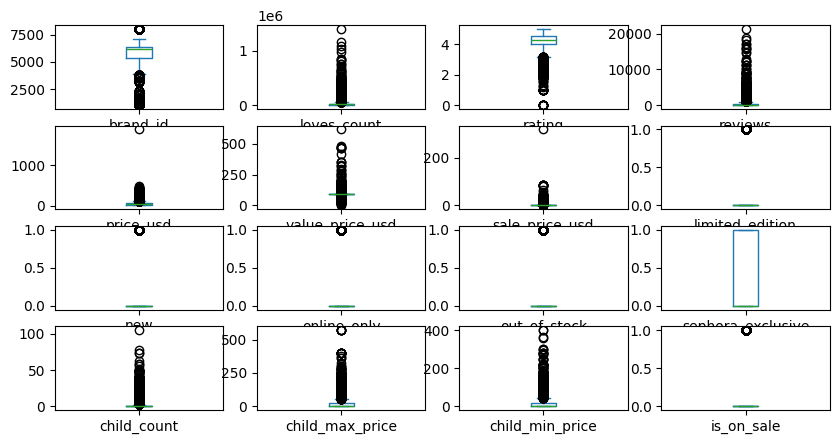

In [38]:
# box plot to visualize outliers
df.plot(kind='box', subplots=True,figsize=(10,5),layout=(4,4))
#plt.savefig('Outliers in Sephora Products.png')
plt.show()

<Axes: xlabel='value_price_usd', ylabel='Count'>

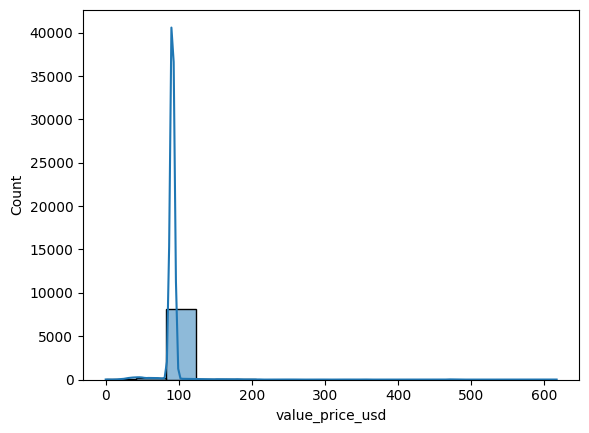

In [39]:
# visualize histplot of load column to check the distribution before handling outliers

sns.histplot(data=df.value_price_usd, kde=True)

<Axes: xlabel='loves_count', ylabel='Count'>

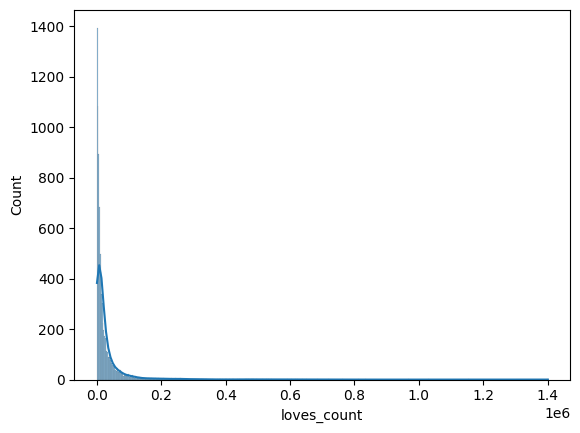

In [40]:
# visualize histplot of load column to check the distribution before handling outliers

sns.histplot(data=df.loves_count, kde=True)

In [41]:
# Function to cap outliers using the IQR method
def cap_outliers_iqr(df, column):
    # Calculate Q1 (25th percentile) and Q3 (75th percentile)
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    
    # Calculate IQR
    IQR = Q3 - Q1
    
    # Define lower and upper limit
    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR
    
    # Cap the values below the lower bound
    df[column] = df[column].apply(lambda x: lower_limit if x < lower_limit else x)
    
    # Cap the values above the upper bound
    df[column] = df[column].apply(lambda x: upper_limit if x > upper_limit else x)

    return df

In [42]:
# List of columns to cap outliers in
columns_to_cap = ['price_usd', 'value_price_usd','sale_price_usd',  'child_count',
                  'child_max_price', 'child_min_price']

# Apply the capping function for the specified columns
for column in columns_to_cap:
    df = cap_outliers_iqr(df, column)

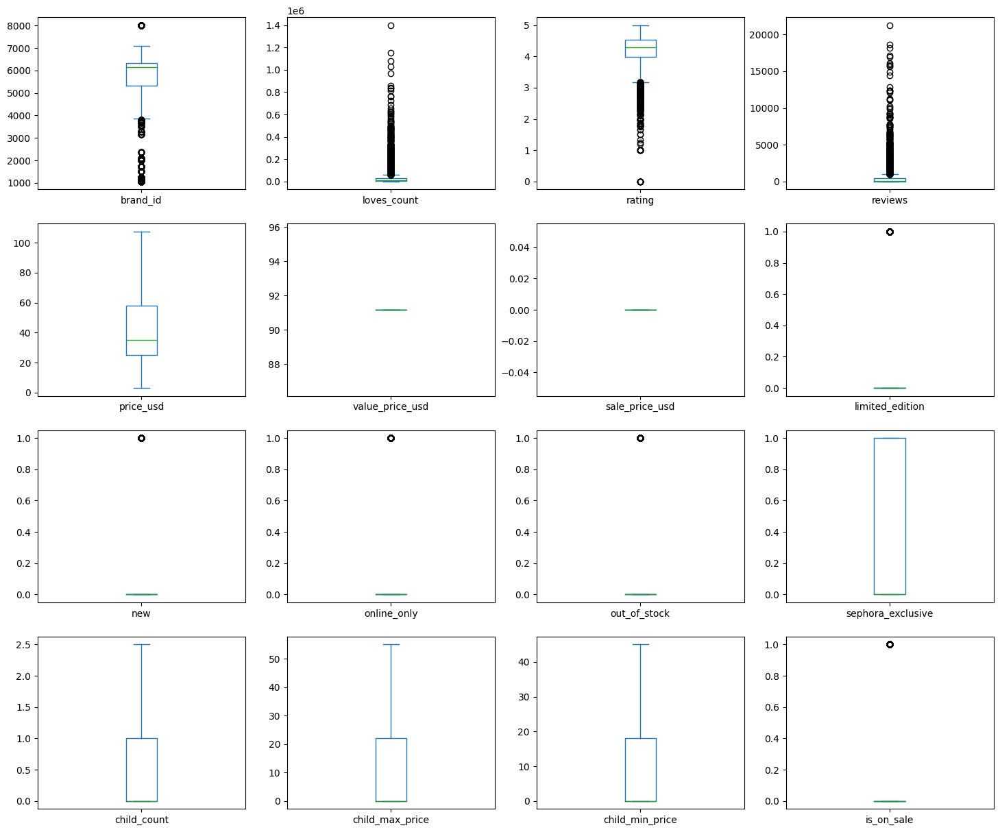

In [43]:
# checking for outliers
df.plot(kind = "box" , subplots = True , figsize = (18,15) ,  layout = (4,4))
#plt.savefig('Handling of outliers.png')
plt.show()

# Exploratory Data Analysis (EDA) 

## Stock prediction:

# 1. Which products are most likely to go out of stock?


In [44]:
# filter out of stock products and create a dataframe
out_of_stock_df = df[df['out_of_stock'] == 1]  

In [45]:
# group the out_of_stocks products by primary category
out_of_stock_counts = out_of_stock_df.groupby('primary_category').size().reset_index(name='count')

In [46]:
out_of_stock_counts = out_of_stock_counts.sort_values(by='count', ascending=False)
out_of_stock_counts

,primary_category,count
3,Makeup,214
1,Fragrance,153
6,Skincare,132
2,Hair,61
5,Mini Size,31
0,Bath & Body,28
4,Men,5
7,Tools & Brushes,2


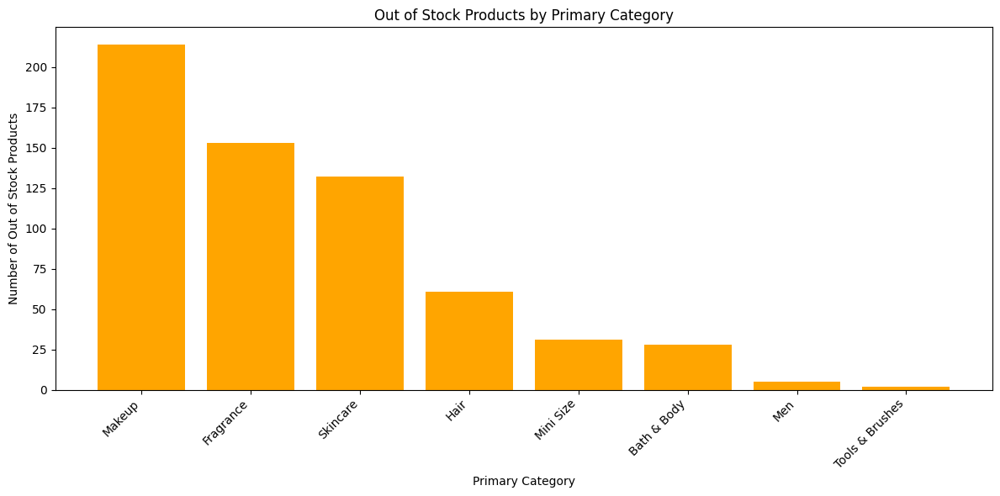

In [47]:
plt.figure(figsize=(12, 6))
plt.bar(out_of_stock_counts['primary_category'], out_of_stock_counts['count'], color='orange')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Primary Category')
plt.ylabel('Number of Out of Stock Products')
plt.title('Out of Stock Products by Primary Category')
plt.tight_layout()
#plt.savefig('Out of Stock Products by Primary Category.png')
plt.show()


### Number of products out of stock versus in stock.

In [48]:
stock_counts = df['out_of_stock'].value_counts().rename(index={0: 'In Stock', 1: 'Out of Stock'})

In [49]:
# Find perecentage of stock
stock_percentages = (stock_counts / stock_counts.sum()) * 100

# add stock count and stock percentages into a dataframe
stock_summary = pd.DataFrame({'Counts': stock_counts,  'Percentages': stock_percentages })
stock_summary

,Counts,Percentages
out_of_stock,,
In Stock,7868,92.630092
Out of Stock,626,7.369908


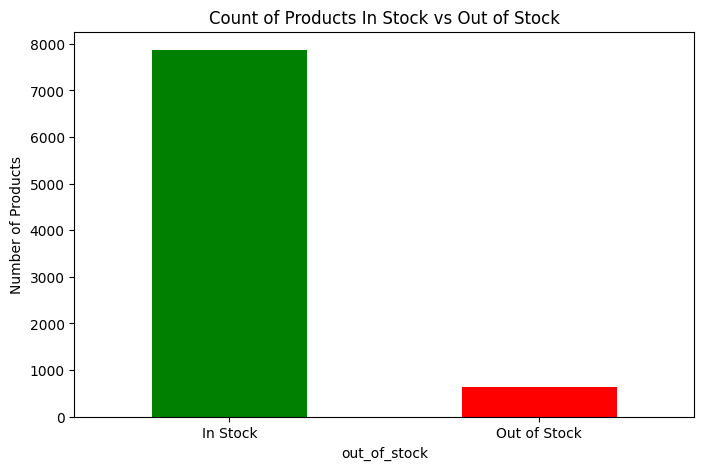

In [50]:
plt.figure(figsize=(8, 5))
stock_summary['Counts'].plot(kind='bar', color=['green', 'red'])
plt.xticks(rotation=0)
plt.ylabel('Number of Products')
plt.title('Count of Products In Stock vs Out of Stock')
#plt.savefig('Count of Products In Stock vs Out of Stock.png')
plt.show()

# 2. What factors (price, customer reviews, popularity) influence stock availability?

### How does price impact stock availability

### Price distribution

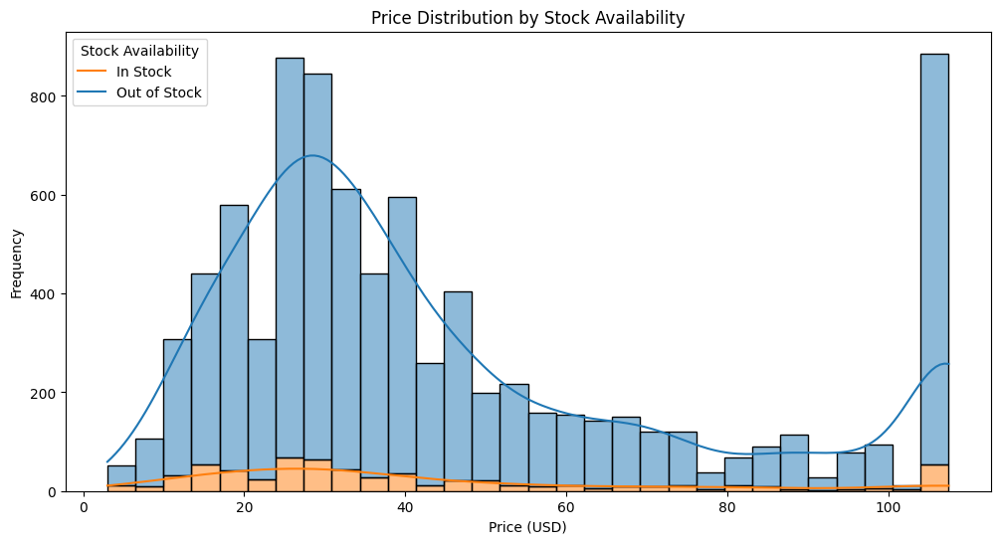

In [51]:
plt.figure(figsize=(12, 6))
sns.histplot(data=df, x='price_usd', hue='out_of_stock', multiple='stack', bins=30, kde=True)
plt.title('Price Distribution by Stock Availability')
plt.xlabel('Price (USD)')
plt.ylabel('Frequency')
plt.legend(title='Stock Availability', labels=['In Stock', 'Out of Stock'])
#plt.savefig('Price Distribution by Stock Availability.png')
plt.show()


### Average Price for Each Stock Status

In [52]:
avg_price = df.groupby('out_of_stock')['price_usd'].mean().reset_index()
avg_price['out_of_stock'] = avg_price['out_of_stock'].replace({0: 'In Stock', 1: 'Out of Stock'})
avg_price

,out_of_stock,price_usd
0,In Stock,45.360084
1,Out of Stock,41.928323


### Prices by stock status

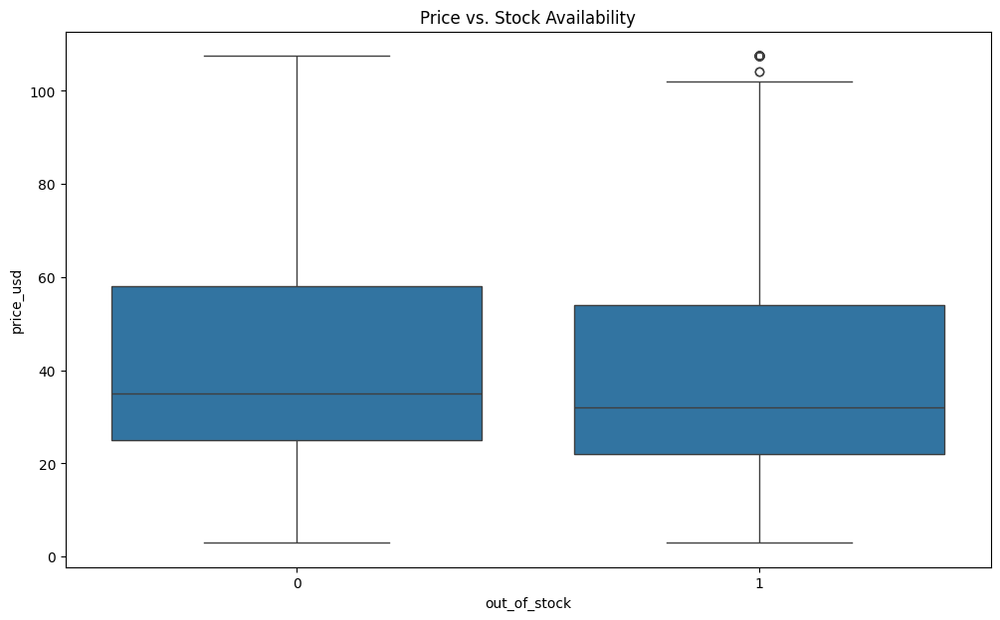

In [53]:
# Boxplot to visualize how price impacts stock availability
plt.figure(figsize=(12, 7))
sns.boxplot(x='out_of_stock', y='price_usd', data=df)
plt.title('Price vs. Stock Availability')
#plt.savefig('Price vs. Stock Availability.png')
plt.show()

## Insights
The products that are out of stock seem to be the ones theprices are lower.

### Other factors affecting stock availability

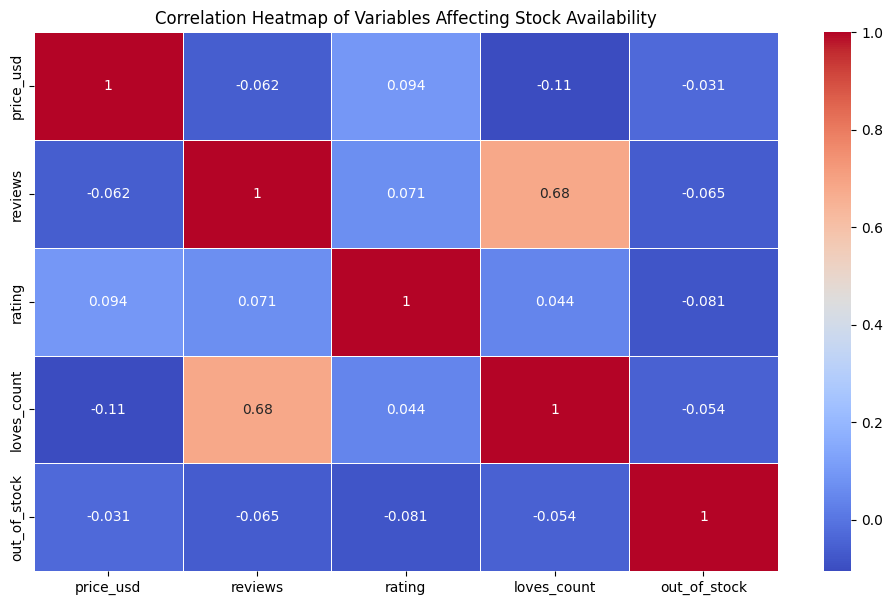

In [54]:
# columns for correlation analysis
corr_columns = ['price_usd', 'reviews', 'rating', 'loves_count', 'out_of_stock']


correlation_matrix = df[corr_columns].corr()

# Plot  heatmap to visualize the correlation
plt.figure(figsize=(12, 7))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap of Variables Affecting Stock Availability')
#plt.savefig('Correlation Heatmap of Variables Affecting Stock Availability.png')
plt.show()

## Insights
Price, reviews, ratings, and popularity have weak correlations with stock status, meaning that stock availability is likely driven by other factors, such as supply chain issues, seasonal demand, or specific product features (like limited edition status).

## Feature engineering

In [55]:
# Group products by primary category and get total count and out_of_stock count
primary_category_agg = df.groupby('primary_category')['out_of_stock'].agg(
    total_products='count', out_of_stock_products='sum').reset_index()

# Calculate the out_of_stock rate
primary_category_agg['out_of_stock_rate'] = (primary_category_agg['out_of_stock_products'] / 
                                             primary_category_agg['total_products']) * 100


primary_category_agg


,primary_category,total_products,out_of_stock_products,out_of_stock_rate
0,Bath & Body,405,28,6.913580
1,Fragrance,1432,153,10.684358
2,Gifts,4,0,0.000000
3,Hair,1464,61,4.166667
4,Makeup,2369,214,9.033347
5,Men,60,5,8.333333
6,Mini Size,288,31,10.763889
7,Skincare,2420,132,5.454545
8,Tools & Brushes,52,2,3.846154


In [56]:
# Group by secondary category
secondary_category_agg = df.groupby('secondary_category')['out_of_stock'].agg(
    total_products='count', out_of_stock_products='sum').reset_index()

secondary_category_agg['out_of_stock_rate'] = (secondary_category_agg['out_of_stock_products'] /
                                               secondary_category_agg['total_products']) * 100
secondary_category_agg.head()

,secondary_category,total_products,out_of_stock_products,out_of_stock_rate
0,Bath & Body,405,28,6.913580
1,Fragrance,1432,153,10.684358
2,Gifts,4,0,0.000000
3,Hair,1464,61,4.166667
4,Makeup,2369,214,9.033347


In [57]:
# Group by tertiary category
tertiary_category_agg = df.groupby('tertiary_category')['out_of_stock'].agg(
    total_products='count', out_of_stock_products='sum').reset_index()

tertiary_category_agg['out_of_stock_rate'] = (tertiary_category_agg['out_of_stock_products'] /
                                              tertiary_category_agg['total_products']) * 100

tertiary_category_agg.head()

,tertiary_category,total_products,out_of_stock_products,out_of_stock_rate
0,Accessories,32,0,0.0
1,Aftershave,5,1,20.0
2,Anti-Aging,50,7,14.0
3,BB & CC Cream,10,0,0.0
4,BB & CC Creams,4,0,0.0


In [58]:
# Merge the primary category trend back into the original dataframe
df = df.merge(primary_category_agg[['primary_category', 'out_of_stock_rate']],
              on='primary_category', how='left')

# Merge secondary category trends
df = df.merge(secondary_category_agg[['secondary_category', 'out_of_stock_rate']],
              on='secondary_category', how='left', suffixes=('', '_secondary'))

# Merge tertiary category trends
df = df.merge(tertiary_category_agg[['tertiary_category', 'out_of_stock_rate']],
              on='tertiary_category', how='left', suffixes=('', '_tertiary'))

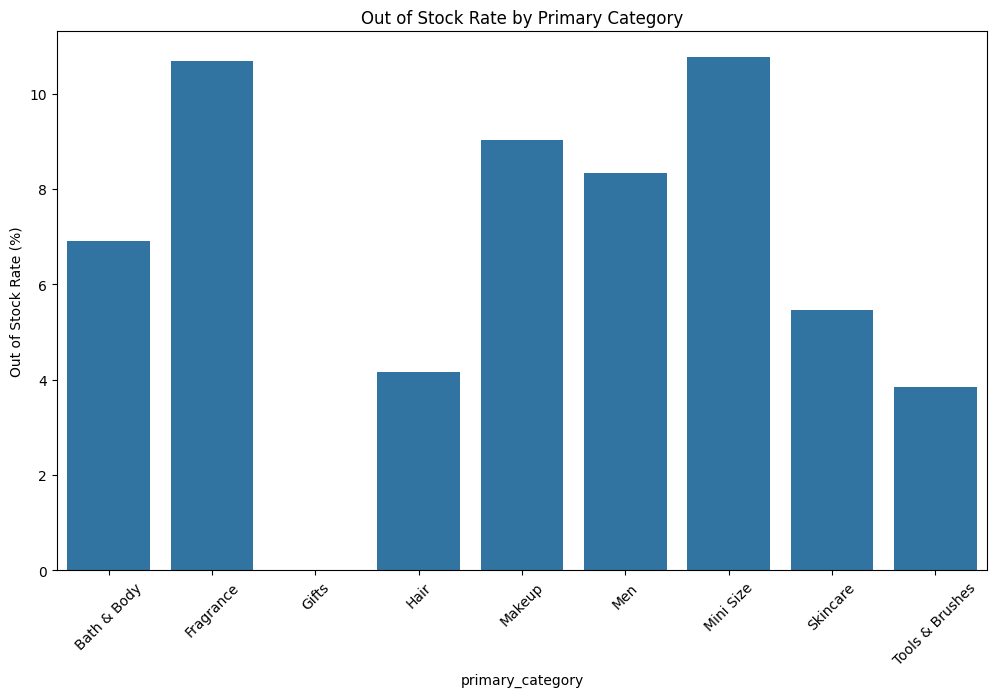

In [59]:

# Bar plot of out_of_stock_rate by primary category
plt.figure(figsize=(12, 7))
sns.barplot(x='primary_category', y='out_of_stock_rate', data=primary_category_agg)
plt.title('Out of Stock Rate by Primary Category')
plt.ylabel('Out of Stock Rate (%)')
plt.xticks(rotation=45)
#plt.savefig('Out of Stock Rate by Primary Category.png')
plt.show()


### Out of stock rate by price bins

In [60]:
# Create price bins (low, medium, high price ranges)
df['price_bins'] = pd.cut(df['price_usd'], bins=[0, 20, 50, 100, np.inf], labels=['Low', 'Medium', 'High', 'Premium'])


In [61]:
# Group by price bands and calculate the out-of-stock rate
price_bins_agg = df.groupby('price_bins', observed=True)['out_of_stock'].agg(
    total_products='count',
    out_of_stock_products='sum'
).reset_index()


price_bins_agg['out_of_stock_rate'] = (price_bins_agg['out_of_stock_products'] / 
                                       price_bins_agg['total_products']) * 100


price_bins_agg

,price_bins,total_products,out_of_stock_products,out_of_stock_rate
0,Low,1487,147,9.885676
1,Medium,4534,316,6.969563
2,High,1575,107,6.793651
3,Premium,898,56,6.236080


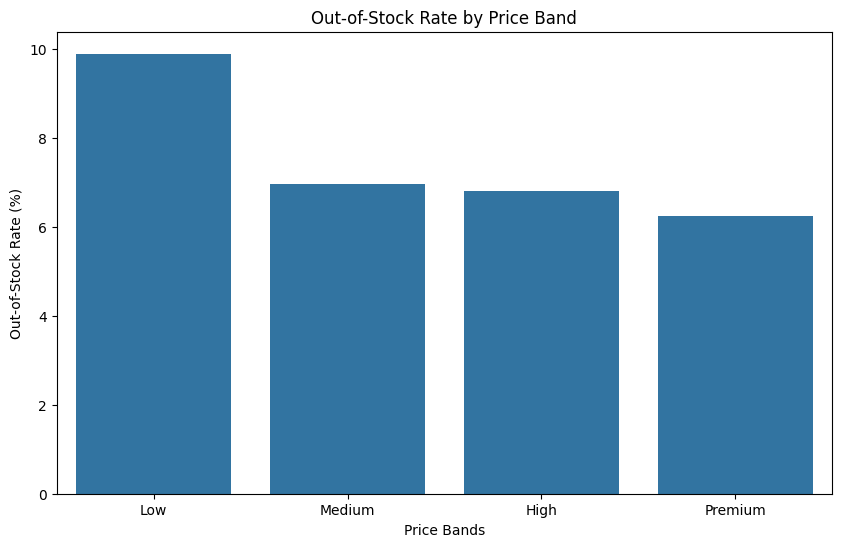

In [62]:
# Bar plot for out-of-stock rate by price band
plt.figure(figsize=(10, 6))
sns.barplot(x='price_bins', y='out_of_stock_rate', data=price_bins_agg)
plt.title('Out-of-Stock Rate by Price Band')
plt.xlabel('Price Bands')
plt.ylabel('Out-of-Stock Rate (%)')
#plt.savefig('Out-of-Stock Rate by Price Band.png')
plt.show()

## Insights

Low priced products are highly likely to go out of stock.

### Customer behaviour by price groups

In [63]:
# Group by price bands and calculate the average rating and reviews
customer_behavior_by_price = df.groupby('price_bins', observed=True).agg(
    avg_rating=('rating', 'mean'), avg_reviews=('reviews', 'mean')).reset_index()


customer_behavior_by_price

,price_bins,avg_rating,avg_reviews
0,Low,4.066703,414.505044
1,Medium,4.198763,507.394795
2,High,4.249877,353.669524
3,Premium,4.243042,286.523385


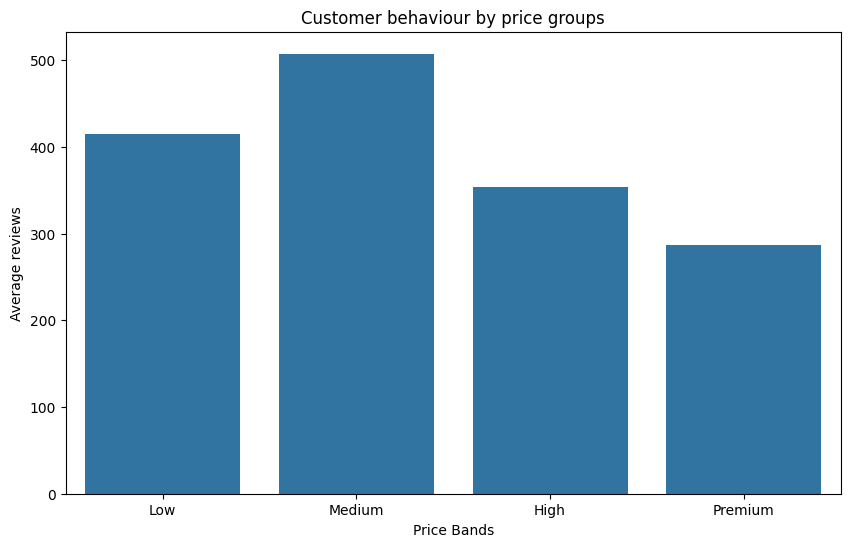

In [64]:
# Bar plot for customer behaviour by price band
plt.figure(figsize=(10, 6))
sns.barplot(x='price_bins', y='avg_reviews', data=customer_behavior_by_price)
plt.title('Customer behaviour by price groups')
plt.xlabel('Price Bands')
plt.ylabel('Average reviews')
#plt.savefig('Customer behaviour by price groups.png')
plt.show()

# 3. How does discounts impact product performance in terms of stock, customer reviews, and ratings?

### Compare Regular vs Sale Price

In [65]:
sale_comparison = df.groupby('is_on_sale').agg(
    avg_rating=('rating', 'mean'),
    avg_reviews=('reviews', 'mean'),
    avg_loves=('loves_count', 'mean'),
    avg_stockout=('out_of_stock', 'mean')
).reset_index()
sale_comparison


,is_on_sale,avg_rating,avg_reviews,avg_loves,avg_stockout
0,0,4.200032,442.660445,29360.264105,0.057028
1,1,3.878242,336.240741,23675.633333,0.581481


## Analyze Price Sensitivity

In [66]:
price_comparison = df.groupby(['price_bins'], observed=True).agg(
    avg_price=('price_usd', 'mean'),
    avg_sale_price=('sale_price_usd', 'mean'),
    avg_reviews=('reviews', 'mean'),
    avg_rating=('rating', 'mean'),
    avg_stockout=('out_of_stock', 'mean')
).reset_index()

price_comparison

,price_bins,avg_price,avg_sale_price,avg_reviews,avg_rating,avg_stockout
0,Low,15.083941,0.0,414.505044,4.066703,0.098857
1,Medium,33.467457,0.0,507.394795,4.198763,0.069696
2,High,71.469524,0.0,353.669524,4.249877,0.067937
3,Premium,107.354677,0.0,286.523385,4.243042,0.062361


# 4. How does sales affect product availability (stockout rates)?

In [67]:
sale_stockout = df.groupby(['price_bins', 'is_on_sale'], observed=True).agg(
    stockout_rate=('out_of_stock', 'mean')
).reset_index()

sale_stockout

,price_bins,is_on_sale,stockout_rate
0,Low,0,0.058442
1,Low,1,0.653465
2,Medium,0,0.054521
3,Medium,1,0.575758
4,High,0,0.062176
5,High,1,0.354839
6,Premium,0,0.058296
7,Premium,1,0.666667


### Customer Behavior and Sale Price

In [68]:
sale_response = df.groupby(['price_bins', 'is_on_sale'], observed=True).agg(
    avg_reviews=('reviews', 'mean'),
    avg_rating=('rating', 'mean')
).reset_index()

# show only the products on sale(is_on_sale == 1)
sale_response_on_sale = sale_response[sale_response['is_on_sale'] == 1]

sale_response_on_sale


,price_bins,is_on_sale,avg_reviews,avg_rating
1,Low,1,239.589109,3.767133
3,Medium,1,417.215909,3.937207
5,High,1,324.903226,3.890319
7,Premium,1,240.333333,4.388950


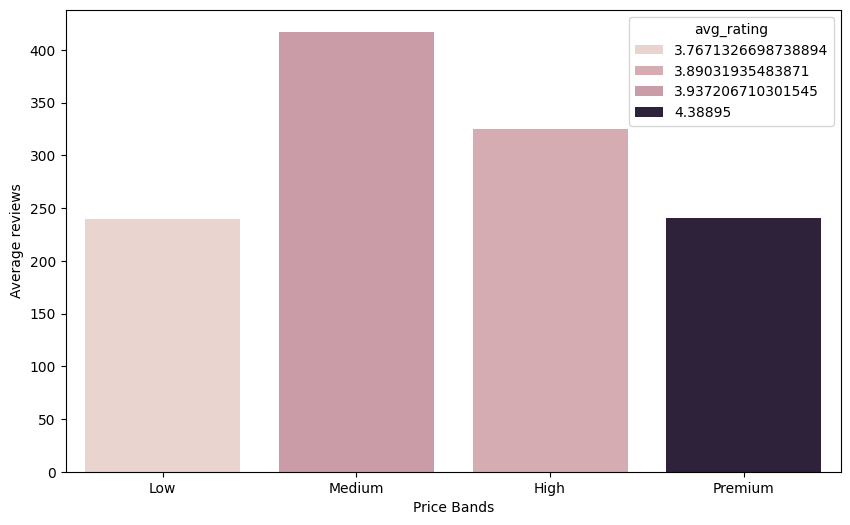

In [69]:
# Bar plot for price affecting stockouts
plt.figure(figsize=(10, 6))
sns.barplot(x='price_bins', y='avg_reviews', hue='avg_rating', data=sale_response_on_sale)
plt.title('')
plt.xlabel('Price Bands')
plt.ylabel('Average reviews')
plt.savefig('Customer behavior and sales.png')
plt.show()

# 5. What is  the impact of pricing strategies (such as discounts and limited edition offerings) on customer satisfaction and sales?

In [70]:
limited_edition_analysis = df.groupby('limited_edition').agg(
    avg_rating=('rating', 'mean'),
    avg_reviews=('reviews', 'mean'),
    avg_loves=('loves_count', 'mean')
).reset_index()

limited_edition_analysis


,limited_edition,avg_rating,avg_reviews,avg_loves
0,0,4.195944,463.490249,30435.481069
1,1,4.108573,118.998325,12566.564489


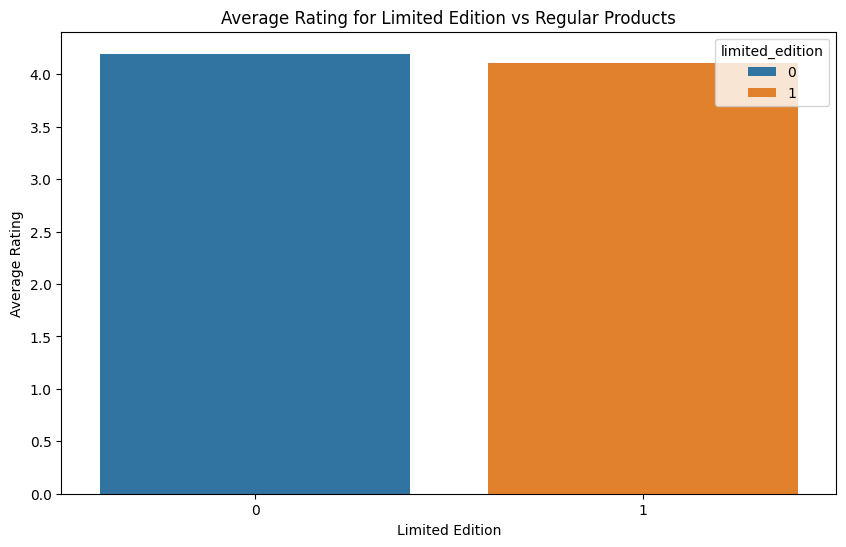

In [71]:
# barplot to show average rating for limited edition products
plt.figure(figsize=(10, 6))
sns.barplot(x='limited_edition', y='avg_rating', data=limited_edition_analysis, hue='limited_edition')
plt.title('Average Rating for Limited Edition vs Regular Products')
plt.xlabel('Limited Edition')
plt.ylabel('Average Rating')
#plt.savefig('Average Rating for Limited Edition vs Regular Products.png')
plt.show()


###  Stockout Rates for Limited Edition vs. Regular Products

In [72]:
stockout_limited_edition_analysis = df.groupby('limited_edition').agg(
    stockout_rate=('out_of_stock', 'mean')).reset_index()

stockout_limited_edition_analysis


,limited_edition,stockout_rate
0,0,0.062049
1,1,0.227806


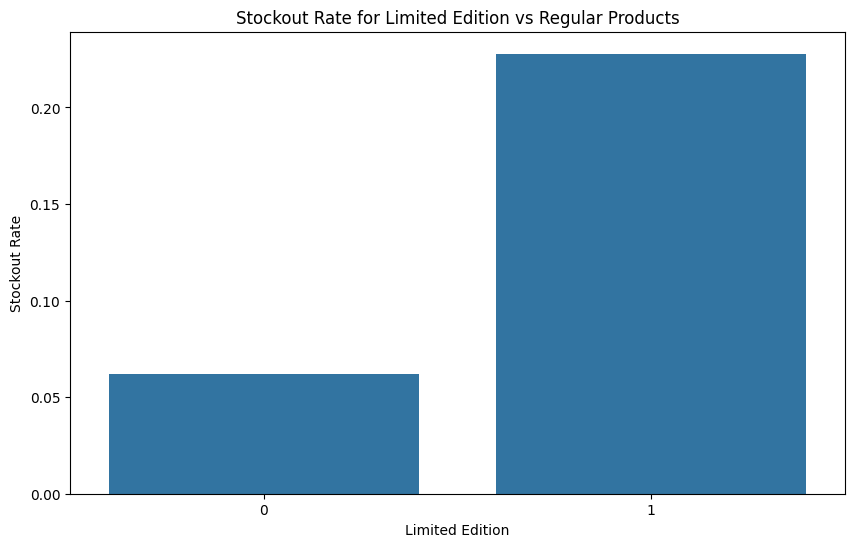

In [73]:
plt.figure(figsize=(10, 6))
sns.barplot(x='limited_edition', y='stockout_rate', data=stockout_limited_edition_analysis)
plt.title('Stockout Rate for Limited Edition vs Regular Products')
plt.xlabel('Limited Edition')
plt.ylabel('Stockout Rate')
#lt.savefig('Stockout Rate for Limited Edition vs Regular Products.png')
plt.show()


In [74]:
# drop unnecessary columns
new_df= df.copy()

new_df.drop(columns=['product_id', 'product_name', 'brand_id', 'brand_name', 'size', 'variation_type', 'variation_value',
       'variation_desc', 'ingredients', 'highlights', 'has_reviews', 'child_count','child_max_price', 'child_min_price',], inplace=True)
new_df.head()

,loves_count,rating,reviews,price_usd,value_price_usd,sale_price_usd,limited_edition,new,online_only,out_of_stock,sephora_exclusive,primary_category,secondary_category,tertiary_category,is_on_sale,out_of_stock_rate,out_of_stock_rate_secondary,out_of_stock_rate_tertiary,price_bins
0,6320,3.6364,11.0,35.0,91.168537,0.0,0,0,1,0,0,Fragrance,Fragrance,Perfume Gift Sets,0,10.684358,10.684358,30.882353,Medium
1,3827,4.1538,13.0,107.5,91.168537,0.0,0,0,1,0,0,Fragrance,Fragrance,Perfume,0,10.684358,10.684358,7.922535,Premium
2,3253,4.2500,16.0,107.5,91.168537,0.0,0,0,1,0,0,Fragrance,Fragrance,Perfume,0,10.684358,10.684358,7.922535,Premium
3,3018,4.4762,21.0,107.5,91.168537,0.0,0,0,1,0,0,Fragrance,Fragrance,Perfume,0,10.684358,10.684358,7.922535,Premium
4,2691,3.2308,13.0,107.5,91.168537,0.0,0,0,1,0,0,Fragrance,Fragrance,Perfume,0,10.684358,10.684358,7.922535,Premium


## Encode categorical columns

In [75]:
# One-hot encoding for categorical variables
new_df = pd.get_dummies(new_df, columns=['primary_category',
       'secondary_category', 'tertiary_category'], drop_first=True)

In [76]:
# instantiate labelencoder object
le = LabelEncoder()

categorical_cols = ['price_bins', 'is_on_sale']

# apply le on categorical feature columns
new_df[categorical_cols] = new_df[categorical_cols].apply(lambda col: le.fit_transform(col))

In [77]:
#new_df.to_csv('cleaned_sephora_dataset.csv', index=False)